# 加载需要的包 #

In [2]:
### scVI合并
#import omicverse as ov
import scanpy as sc
import os
import matplotlib.pyplot as plt
import pandas as pd
import omicverse as ov
import scvi

In [3]:
from pathlib import Path
import anndata as ad
import numpy as np
import scrublet as scr
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl

In [4]:
%matplotlib inline
sns.set_theme(
    context="paper",
    style="white",
    font="Arial",
    font_scale=1.5,
    rc={
        "font.size": 20.0,
        "font.family": ["sans-serif"],
        "font.sans-serif": ["Arial", "sans-serif", "Helvetica", "DejaVu Sans", "Bitstream Vera Sans"],
    },
)
Colors = '''#c886ba #5cbb5e #9751a0 #84b941 #8e6db0 #bbbb3c #5667b0 #e58824 #778cc6 #d6ac3d
#785aa5 #204a87 #36384a #5ec08d #e53e77 #50c1b4 #dd464a #3bbbc6 #d6552c #5baada #cf8a34 #4d62ad
#8b8a34 #a34f9a #9db36b #cb4188 #37825c #b23d4f #5d7131 #b59ac9 #a55725 #5277af #e38f68 #86619d
#caa56a #9c476d #886a2c #dd81a9'''.split()
mpl.rcParams['pdf.fonttype'] = 42

# 数据预处理 #

## 人胚胎胃和食管 ##

In [44]:
adata = sc.read_mtx("/storage/zengjianyangLab/hulei/Fenglei/project/00.encode/03.cross_species/01.rawdata/01.human_embryo/Table_fetal_atlas_count.mtx.gz").T  

In [45]:
adata

AnnData object with n_obs × n_vars = 155232 × 28691

In [46]:
#1. 读取基因和细胞ID（改用pandas）
genes = pd.read_csv("/storage/zengjianyangLab/hulei/Fenglei/project/00.encode/03.cross_species/01.rawdata/01.human_embryo/Table_fetal_atlas_gene_symbol.csv.gz", header=None)[0].values
cells = pd.read_csv("/storage/zengjianyangLab/hulei/Fenglei/project/00.encode/03.cross_species/01.rawdata/01.human_embryo/Table_fetal_atlas_cell_index.csv.gz", header=None)[0].values

#2.检查维度
assert adata.n_vars == len(genes), "基因数不匹配！"
assert adata.n_obs == len(cells), "细胞数不匹配！"

#3. 赋值名称
adata.var_names = genes  # 基因名
adata.obs_names = cells  # 细胞ID

In [47]:
adata

AnnData object with n_obs × n_vars = 155232 × 28691

In [48]:
# 3. 读取meta信息
meta = pd.read_csv("/storage/zengjianyangLab/hulei/Fenglei/project/00.encode/03.cross_species/01.rawdata/01.human_embryo/Table_fetal_atlas_meta_info.csv.gz", index_col=0)
adata.obs = meta.loc[adata.obs_names]  # 确保顺序对齐

In [49]:
adata

AnnData object with n_obs × n_vars = 155232 × 28691
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'Age', 'Tissue', 'Individual', 'Sample', 'Organ', 'Age_week', 'Major_cell_type', 'sorted_cluster_idx', 'cluster_col', 'Organ_group', 'Corrected_organ_group', 'Corrected_organ', 'Corrected_tissue', 'UMAP_X', 'UMAP_Y', 'Cell_type'

In [50]:
adata.obs.head()

,orig.ident,nCount_RNA,nFeature_RNA,percent.mito,Age,Tissue,Individual,Sample,Organ,Age_week,Major_cell_type,sorted_cluster_idx,cluster_col,Organ_group,Corrected_organ_group,Corrected_organ,Corrected_tissue,UMAP_X,UMAP_Y,Cell_type
S1_AAACCTGAGATCACGG,S1,3848,1982,0.023614,d122,Duodenum,HT-01,Sample_HT-01_d122_Duodenum_1,SI,17,Immune,27,#B5CAE6,Intestine,Intestine,SI,Duodenum,8.584060,10.939204,T cell/NK cell 2
S1_AAACCTGGTCTCATCC,S1,27509,5617,0.056664,d122,Duodenum,HT-01,Sample_HT-01_d122_Duodenum_1,SI,17,Epithelial,6,#A72029,Intestine,Intestine,SI,Duodenum,11.636572,-9.030709,Intestinal epithelium
S1_AAACCTGGTGCCTGGT,S1,12227,3503,0.069831,d122,Duodenum,HT-01,Sample_HT-01_d122_Duodenum_1,SI,17,Epithelial,6,#A72029,Intestine,Intestine,SI,Duodenum,12.023963,-9.224837,Intestinal epithelium
S1_AAACCTGGTGTAAGTA,S1,19588,4755,0.082915,d122,Duodenum,HT-01,Sample_HT-01_d122_Duodenum_1,SI,17,Epithelial,6,#A72029,Intestine,Intestine,SI,Duodenum,11.675339,-9.621010,Intestinal epithelium
S1_AAACCTGTCGTAGGAG,S1,5946,2493,0.033874,d122,Duodenum,HT-01,Sample_HT-01_d122_Duodenum_1,SI,17,Mesenchymal,12,#39704C,Intestine,Intestine,SI,Duodenum,-0.448587,4.309812,Proliferative mesenchyme


In [51]:
print(adata.obs["Sample"].unique())

['Sample_HT-01_d122_Duodenum_1' 'Sample_HT-01_d122_Duodenum_2'
 'Sample_HT-172_d127_Duodenum_1' 'Sample_HT-172_d127_Duodenum_2'
 'Sample_HT-182_d125_Lung-airway-trachea' 'Sample_HT-182_d125_Lung-distal'
 'Sample_HT-184_d85_Duodenum' 'Sample_HT-187_d103_Lung-airway'
 'Sample_HT-187_d103_Lung-distal' 'Sample_HT-187_d103_Lung-tracheal-epi'
 'Sample_HT-189_d145_Lung-tracheal-epi' 'Sample_HT-228_d101_Colon'
 'Sample_HT-228_d101_Duodenum' 'Sample_HT-228_d101_Ileum'
 'Sample_HT-228_d101_Liver' 'Sample_HT-231_d117_Esophagus'
 'Sample_HT-231_d117_Stomach-antrum' 'Sample_HT-231_d117_Stomach-corpus'
 'Sample_HT-232_d100_Esophagus' 'Sample_HT-232_d100_Stomach-antrum'
 'Sample_HT-232_d100_Stomach-corpus' 'Sample_HT-234_d80_Colon'
 'Sample_HT-234_d80_Duodenum' 'Sample_HT-234_d80_Ileum'
 'Sample_HT-234_d80_Jejunum' 'Sample_HT-234_d80_Lung-airway'
 'Sample_HT-234_d80_Lung-distal' 'Sample_HT-236_d132_Colon'
 'Sample_HT-236_d132_Duodenum' 'Sample_HT-236_d132_Ileum'
 'Sample_HT-243_d47_Small-intestine' '

In [52]:
# 统计每个Sample的细胞数目
sample_counts = adata.obs["Sample"].value_counts()

# 打印结果
print(sample_counts)

Sample
Sample_HT-182_d125_Lung-distal                15564
Sample_HT-182_d125_Lung-airway-trachea         8055
Sample_HT-01_d122_Duodenum_2                   7264
Sample_HT-234_d80_Lung-distal                  7184
Sample_HT-187_d103_Lung-distal                 6745
Sample_HT-228_d101_Ileum                       6488
Sample_HT-187_d103_Lung-airway                 6040
Sample_HT-236_d132_Duodenum                    5610
Sample_HT-236_d132_Colon                       5512
Sample_HT-260_d59_Proximal-small-intestine     5115
Sample_HT-243_d47_Stomach                      5068
Sample_HT-172_d127_Duodenum_2                  4766
Sample_HT-172_d127_Duodenum_1                  4397
Sample_HT-234_d80_Lung-airway                  4321
Sample_HT-236_d132_Ileum                       4315
Sample_HT-234_d80_Jejunum                      4312
Sample_HT-243_d47_Small-intestine              4236
Sample_HT-228_d101_Duodenum                    4201
Sample_HT-228_d101_Liver                       4075
Sampl

In [53]:
# 重命名QC列（保留原始列，新增标准列）
adata.obs['total_counts'] = adata.obs['nCount_RNA']          # 总UMI数
adata.obs['n_genes_by_counts'] = adata.obs['nFeature_RNA']   # 检测到的基因数
adata.obs['pct_counts_mt'] = adata.obs['percent.mito']        # 线粒体基因占比

# 可选：删除原始列
# adata.obs.drop(['nCount_RNA', 'nFeature_RNA', 'percent.mito'], axis=1, inplace=True)

adata

AnnData object with n_obs × n_vars = 155232 × 28691
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'Age', 'Tissue', 'Individual', 'Sample', 'Organ', 'Age_week', 'Major_cell_type', 'sorted_cluster_idx', 'cluster_col', 'Organ_group', 'Corrected_organ_group', 'Corrected_organ', 'Corrected_tissue', 'UMAP_X', 'UMAP_Y', 'Cell_type', 'total_counts', 'n_genes_by_counts', 'pct_counts_mt'

In [54]:
# 定义输出目录
output_dir = "/storage/zengjianyangLab/hulei/Fenglei/project/00.encode/03.cross_species/01.rawdata/01.human_embryo/"

# 确保输出目录存在
os.makedirs(output_dir, exist_ok=True)

# 定义样本名到输出文件名的映射规则
sample_to_filename = {
    'Sample_HT-231_d117_Esophagus': 'human_e117_esophagus.h5ad',
    'Sample_HT-231_d117_Stomach-antrum': 'human_e117_stomach_antrum.h5ad',
    'Sample_HT-231_d117_Stomach-corpus': 'human_e117_stomach_corpus.h5ad',
    'Sample_HT-243_d47_Stomach': 'human_e47_stomach.h5ad'
}

# 遍历每个样本并保存
for sample_name, output_filename in sample_to_filename.items():
    # 检查样本是否存在
    if sample_name not in adata.obs['Sample'].values:
        print(f"警告：样本 '{sample_name}' 不存在，跳过")
        continue
    
    # 提取子集（.copy() 确保独立对象）
    adata_subset = adata[adata.obs['Sample'] == sample_name].copy()
    
    # 拼接完整输出路径
    output_path = os.path.join(output_dir, output_filename)
    
    # 保存为h5ad文件
    adata_subset.write(output_path)
    print(f"已保存: {sample_name} -> {output_path}")

print("所有样本处理完成！")

已保存: Sample_HT-231_d117_Esophagus -> /storage/zengjianyangLab/hulei/Fenglei/project/00.encode/03.cross_species/01.rawdata/01.human_embryo/human_e117_esophagus.h5ad
已保存: Sample_HT-231_d117_Stomach-antrum -> /storage/zengjianyangLab/hulei/Fenglei/project/00.encode/03.cross_species/01.rawdata/01.human_embryo/human_e117_stomach_antrum.h5ad
已保存: Sample_HT-231_d117_Stomach-corpus -> /storage/zengjianyangLab/hulei/Fenglei/project/00.encode/03.cross_species/01.rawdata/01.human_embryo/human_e117_stomach_corpus.h5ad
已保存: Sample_HT-243_d47_Stomach -> /storage/zengjianyangLab/hulei/Fenglei/project/00.encode/03.cross_species/01.rawdata/01.human_embryo/human_e47_stomach.h5ad
所有样本处理完成！


## 统一人牛基因名 ##

In [55]:
from functools import reduce

In [56]:
# 输入和输出目录
human_dir = "/storage/zengjianyangLab/hulei/Fenglei/project/00.encode/03.cross_species/01.rawdata/01.human_embryo/"
cattle_dir = "/storage/zengjianyangLab/hulei/Fenglei/project/05.rumi_atlas_scVI/02.batch_scvi/01.cattle/01.qc/"
output_dir = "/storage/zengjianyangLab/hulei/Fenglei/project/00.encode/03.cross_species/01.rawdata/02.batch/00.raw_h5ad/"

# 确保输出目录存在
os.makedirs(output_dir, exist_ok=True)

# 第一组文件列表（人类）
human_files = [
    "human_e47_stomach.h5ad",
    "human_e117_esophagus.h5ad",
    "human_e117_stomach_antrum.h5ad",
    "human_e117_stomach_corpus.h5ad"
]

# 第二组文件列表（牛）
cattle_files = [
    "abomasum.h5ad",
    "esophagus.h5ad",
    "omasum.h5ad",
    "reticulum.h5ad",
    "rumen.h5ad"
]

# 加载所有数据集并收集基因列表
all_genes = []
datasets = []

# 加载人类数据
for file in human_files:
    path = os.path.join(human_dir, file)
    adata = sc.read_h5ad(path)
    datasets.append((adata, file, "human"))
    all_genes.append(set(adata.var_names))

# 加载牛数据
for file in cattle_files:
    path = os.path.join(cattle_dir, file)
    adata = sc.read_h5ad(path)
    datasets.append((adata, file, "cattle"))
    all_genes.append(set(adata.var_names))

# 计算所有数据集的共同基因
common_genes = list(reduce(lambda x, y: x & y, all_genes))
print(f"共同基因数量: {len(common_genes)}")

# 过滤并保存每个数据集
for adata, file, group in datasets:
    # 保留共同基因
    adata_filtered = adata[:, common_genes].copy()
    
    # 设置输出文件名
    if group == "human":
        output_file = f"human_{file}"
    else:
        output_file = f"cattle_{file}"
    
    # 保存到目标目录
    output_path = os.path.join(output_dir, output_file)
    adata_filtered.write(output_path)
    print(f"已保存: {output_path} (细胞数={adata_filtered.n_obs}, 基因数={adata_filtered.n_vars})")

print("处理完成！")

共同基因数量: 15098
已保存: /storage/zengjianyangLab/hulei/Fenglei/project/00.encode/03.cross_species/01.rawdata/02.batch/00.raw_h5ad/human_human_e47_stomach.h5ad (细胞数=5068, 基因数=15098)
已保存: /storage/zengjianyangLab/hulei/Fenglei/project/00.encode/03.cross_species/01.rawdata/02.batch/00.raw_h5ad/human_human_e117_esophagus.h5ad (细胞数=1796, 基因数=15098)
已保存: /storage/zengjianyangLab/hulei/Fenglei/project/00.encode/03.cross_species/01.rawdata/02.batch/00.raw_h5ad/human_human_e117_stomach_antrum.h5ad (细胞数=1409, 基因数=15098)
已保存: /storage/zengjianyangLab/hulei/Fenglei/project/00.encode/03.cross_species/01.rawdata/02.batch/00.raw_h5ad/human_human_e117_stomach_corpus.h5ad (细胞数=1644, 基因数=15098)
已保存: /storage/zengjianyangLab/hulei/Fenglei/project/00.encode/03.cross_species/01.rawdata/02.batch/00.raw_h5ad/cattle_abomasum.h5ad (细胞数=13743, 基因数=15098)
已保存: /storage/zengjianyangLab/hulei/Fenglei/project/00.encode/03.cross_species/01.rawdata/02.batch/00.raw_h5ad/cattle_esophagus.h5ad (细胞数=13425, 基因数=15098)
已保存: /st

# 数据合并 #

In [5]:
save_folder = f"/storage2/zengjianyangLab/hulei/Fenglei/project/11.help_mjr/01.SFRP2_PP/02.batch"
Path(save_folder).mkdir(parents=True, exist_ok=True)

In [29]:
sample_list = ['ABPC','SFRP2','PP']

In [30]:
#os.chdir("/home/lzh/projection/mhl_new/05.bud_compare")
adata_dict = {}
for i in sample_list:
    adata = ad.read_h5ad(f'/storage2/zengjianyangLab/hulei/Fenglei/project/11.help_mjr/01.SFRP2_PP/01.qc/qc/{i}.h5ad')
    adata_dict[i] = adata.copy()
    del adata

In [31]:
# 确保每个 AnnData 对象的变量名唯一
for adata in adata_dict.values():
    adata.var_names_make_unique()  # 默认会在重复名后加 "-1", "-2" 等

# 然后合并
adata = sc.concat(
    adata_dict.values(),
    label='stage',
    keys=adata_dict.keys(),
    index_unique='-'
)

In [32]:
print(adata.obs["stage"].unique())

['ABPC', 'SFRP2', 'PP']
Categories (3, object): ['ABPC', 'SFRP2', 'PP']


In [33]:
adata.write_h5ad(filename=f'{save_folder}/all_cell_raw_PP.h5ad', compression='gzip')

# 去批次 #

## scVI ##

In [34]:
adata.layers['counts'] = adata.X.copy()

In [35]:
#adata = adata[: ,~adata.var_names.str.startswith(("RPS",'RPL','MT-'))]
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.layers['X_log1p'] = adata.X.copy()
adata.raw = adata
adata.write_h5ad(filename=f"{save_folder}/all_cell_raw_v2.h5ad", compression="gzip")

In [36]:
#adata=translate(adata)
with open('/storage/zengjianyangLab/hulei/Fenglei/project/03.rumen_hg/02.batch/02.scVI/00.other/g2m_genes.txt') as f:
    g2m_genes = [i.strip() for i in f.readlines()]
    g2m_genes = [i for i in g2m_genes if i in adata.var_names]
with open('/storage/zengjianyangLab/hulei/Fenglei/project/03.rumen_hg/02.batch/02.scVI/00.other/s_genes.txt') as f:
    s_genes = [i.strip() for i in f.readlines()]
    s_genes = [i for i in s_genes if i in adata.var_names]
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)
adata.obs['cc_diff'] = adata.obs['G2M_score'] -  adata.obs['S_score']

In [37]:
sc.experimental.pp.highly_variable_genes(
        adata, flavor="pearson_residuals", n_top_genes=3000,batch_key='stage'
    )

adata_scvi = adata[:, adata.var["highly_variable"]].copy()

In [38]:
#配置训练模型
scvi.model.SCVI.setup_anndata(adata_scvi, layer="counts", batch_key='stage')
adata_scvi

AnnData object with n_obs × n_vars = 33397 × 3000
    obs: 'n_genes', 'percent_mito', 'n_counts', 'doublet_score', 'predicted_doublet', 'stage', 'S_score', 'G2M_score', 'phase', 'cc_diff', '_scvi_batch', '_scvi_labels'
    var: 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable_nbatches', 'highly_variable_intersection', 'highly_variable'
    uns: 'log1p', 'hvg', '_scvi_uuid', '_scvi_manager_uuid'
    layers: 'counts', 'X_log1p'

In [39]:
#创建训练模型
vae = scvi.model.SCVI(adata_scvi, n_layers=2, n_latent=30, gene_likelihood="nb")
#Now we train scVI. This should take a couple of minutes on a Colab session
vae.train()

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 240/240: 100%|██████████| 240/240 [05:08<00:00,  1.28s/it, v_num=1, train_loss_step=199, train_loss_epoch=214]

`Trainer.fit` stopped: `max_epochs=240` reached.


Epoch 240/240: 100%|██████████| 240/240 [05:08<00:00,  1.28s/it, v_num=1, train_loss_step=199, train_loss_epoch=214]


In [40]:
adata.obsm["X_scVI"] = vae.get_latent_representation()

In [41]:
sc.pp.neighbors(adata,use_rep='X_scVI')
sc.tl.umap(adata)

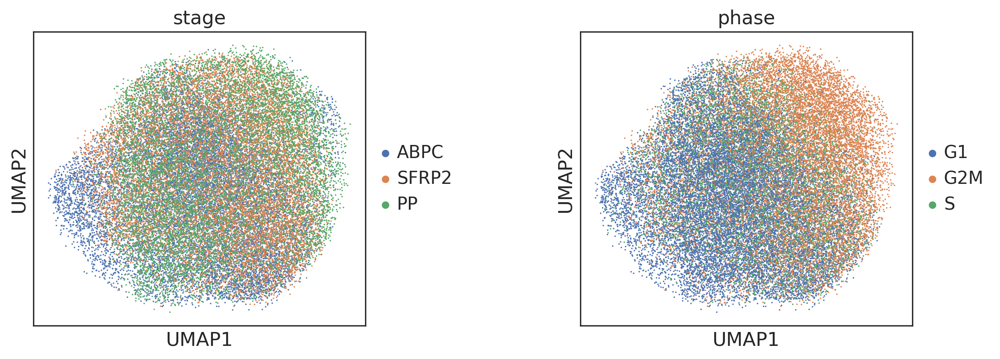

In [42]:
#sc.tl.umap(adata)
fig = sc.pl.umap(adata,color=['stage','phase'],
    ncols=3, hspace=0.3, wspace=0.5, size=5,
    return_fig=True, show=True)
fig.savefig(f'{save_folder}/01.major_celltype_scVI/01.all_cell_scVI_qc_umap_PP.pdf')

In [43]:
adata.write_h5ad(filename=f"{save_folder}/all_cell_scVI_PP.h5ad", compression="gzip")

In [72]:
### 大类注释 ###

## harmony ##

In [44]:
adata = sc.read_h5ad('/storage2/zengjianyangLab/hulei/Fenglei/project/11.help_mjr/01.SFRP2_PP/02.batch/all_cell_raw_PP_v2.h5ad')
adata

AnnData object with n_obs × n_vars = 33397 × 22119
    obs: 'n_genes', 'percent_mito', 'n_counts', 'doublet_score', 'predicted_doublet', 'stage'
    uns: 'log1p'
    layers: 'X_log1p', 'counts'

In [45]:
#adata=translate(adata)
with open('/storage/zengjianyangLab/hulei/Fenglei/project/03.rumen_hg/02.batch/02.scVI/00.other/g2m_genes.txt') as f:
    g2m_genes = [i.strip() for i in f.readlines()]
    g2m_genes = [i for i in g2m_genes if i in adata.var_names]
with open('/storage/zengjianyangLab/hulei/Fenglei/project/03.rumen_hg/02.batch/02.scVI/00.other/s_genes.txt') as f:
    s_genes = [i.strip() for i in f.readlines()]
    s_genes = [i for i in s_genes if i in adata.var_names]
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)
adata.obs['cc_diff'] = adata.obs['G2M_score'] -  adata.obs['S_score']

In [46]:
adata.obs.head()

,n_genes,percent_mito,n_counts,doublet_score,predicted_doublet,stage,S_score,G2M_score,phase,cc_diff
AAACCCAAGCAAACAT-1-ABPC,1204,0.035508,2591.0,0.020115,False,ABPC,-0.046980,-0.076321,G1,-0.029342
AAACCCAAGCGTATAA-1-ABPC,1129,0.045433,2091.0,0.230233,False,ABPC,0.110792,-0.164323,S,-0.275116
AAACCCAAGGTTATAG-1-ABPC,1420,0.027266,2604.0,0.280000,False,ABPC,-0.131477,-0.136499,G1,-0.005022
AAACCCACACCATTCC-1-ABPC,2215,0.023444,5204.0,0.202028,False,ABPC,-0.080170,-0.228305,G1,-0.148135
AAACCCACACCGGAAA-1-ABPC,1096,0.038354,2138.0,0.105874,False,ABPC,0.095694,-0.156656,S,-0.252350


In [47]:
sc.experimental.pp.highly_variable_genes(
        adata, flavor="pearson_residuals", n_top_genes=2000,batch_key='stage'
    )

adata

AnnData object with n_obs × n_vars = 33397 × 22119
    obs: 'n_genes', 'percent_mito', 'n_counts', 'doublet_score', 'predicted_doublet', 'stage', 'S_score', 'G2M_score', 'phase', 'cc_diff'
    var: 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable_nbatches', 'highly_variable_intersection', 'highly_variable'
    uns: 'log1p', 'hvg'
    layers: 'X_log1p', 'counts'

In [48]:
#会自动调用取过得高变
sc.pp.pca(adata)

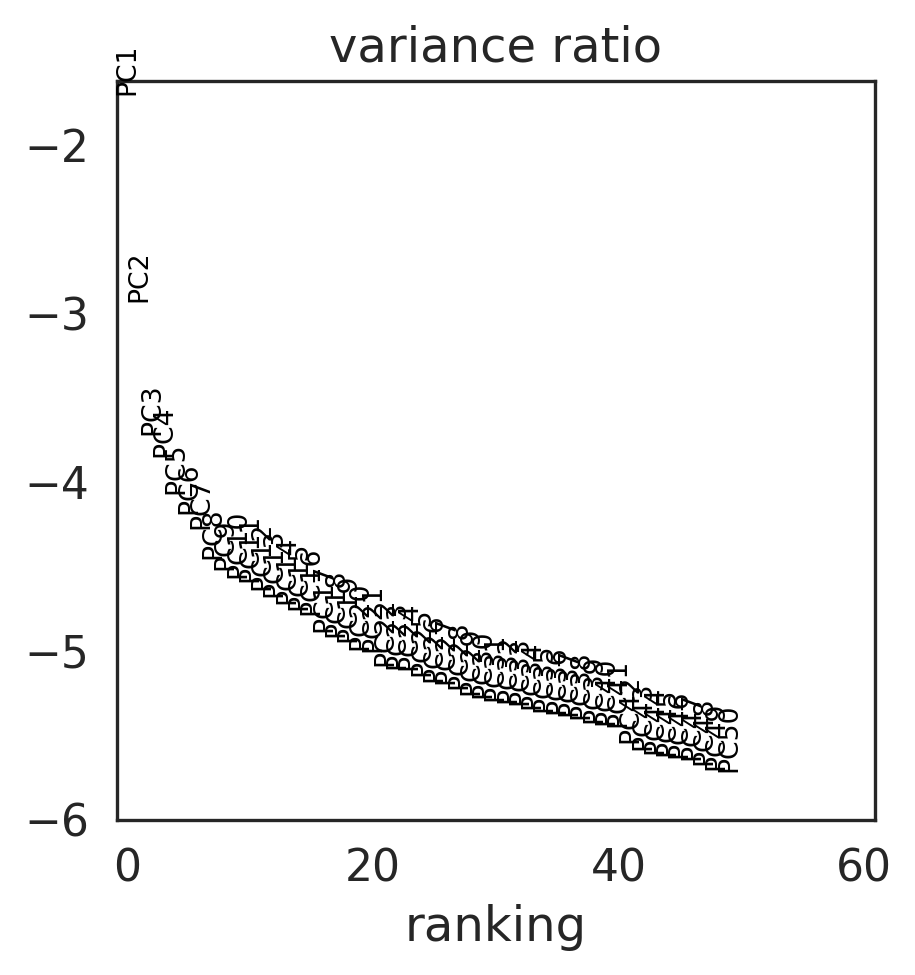

In [49]:
sc.pl.pca_variance_ratio(adata, n_pcs=60, log=True)

### 未去批次 ###

In [50]:
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=50, use_rep="X_pca")
sc.tl.umap(adata)
sc.tl.leiden(adata)

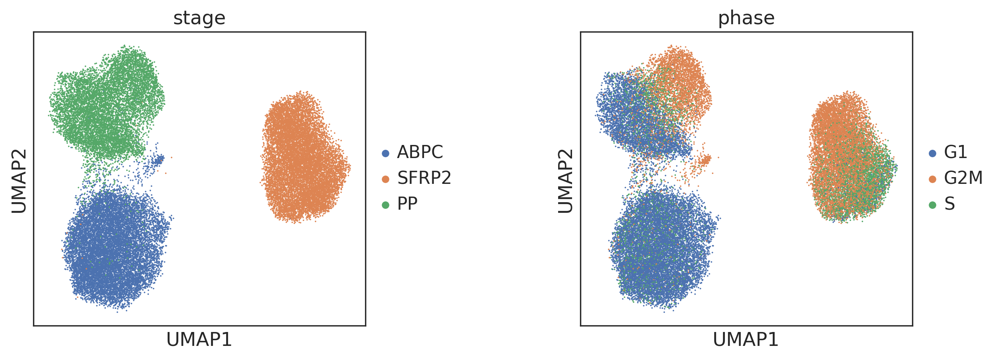

In [51]:
fig = sc.pl.umap(adata,color=['stage','phase'],
    ncols=3, hspace=0.3, wspace=0.5, size=5,
    return_fig=True, show=True)
fig.savefig(f'{save_folder}/01.major_celltype_harmony/01.all_cell_batch_raw_umap_PP.pdf')

### 去批次 ###

In [52]:
sc.external.pp.harmony_integrate(adata, key="stage", basis='X_pca', adjusted_basis='X_pca_harmony')
##max_iter_harmony=50, theta=2
#max_iter_harmony（最大迭代次数）,指定 Harmony 算法的最大迭代次数。每次迭代会尝试优化批次间的对齐效果。增大值,更严格的收敛条件，适合复杂批次效应（如批次间差异大），但计算时间更长;减小值,加速运行，但可能未完全收敛
#theta，控制批次校正的强度，值越大，批次间的差异校正越强（但可能过度校正，损失真实生物学差异）。增大值,适用于批次效应非常强的情况（如不同实验平台的数据）;减小值,适用于轻微批次效应（如同一实验的不同日期），保留更多生物学变异。

2025-08-18 13:09:51,908 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-08-18 13:10:01,401 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-08-18 13:10:01,490 - harmonypy - INFO - Iteration 1 of 10
2025-08-18 13:10:06,468 - harmonypy - INFO - Iteration 2 of 10
2025-08-18 13:10:11,457 - harmonypy - INFO - Converged after 2 iterations


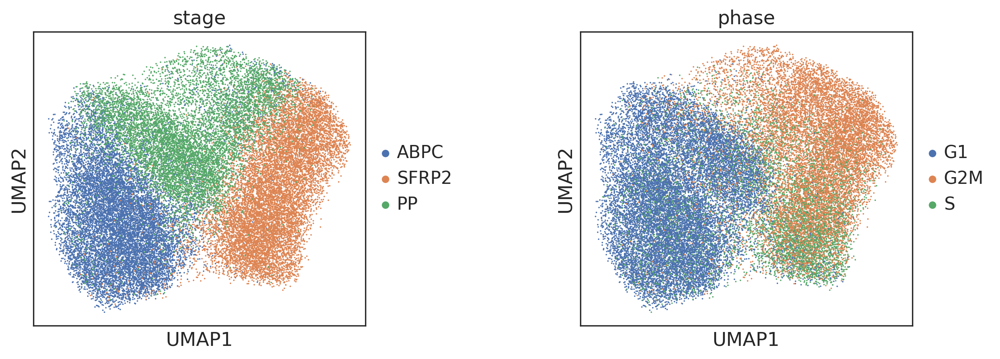

In [53]:
sc.pp.neighbors(adata, use_rep='X_pca_harmony', key_added='harmony_nn')
sc.tl.umap(adata, neighbors_key='harmony_nn')
fig = sc.pl.umap(adata,color=['stage','phase'],
    ncols=3, hspace=0.3, wspace=0.5, size=5,
    return_fig=True, show=True)
fig.savefig(f'{save_folder}/01.major_celltype_harmony/01.all_cell_batch_harmony_umap_PP.pdf')
#adata.write('cattle.h5ad')

# 等价于
# import harmonypy
# harmony_out = harmonypy.run_harmony(adata.obsm["X_pca"], adata.obs, 'batch')
# adata.obsm[adjusted_basis] = harmony_out.Z_corr.T ### obsm 就是降维的数据

In [54]:
adata.write_h5ad(filename=f"{save_folder}/all_cell_harmony_PP.h5ad", compression="gzip")

In [6]:
adata = sc.read(f"{save_folder}/all_cell_harmony_PP.h5ad")

In [ ]:
sc.pl.umap(
    adata,
    color=['GPNMB','NID','NRG1','FGFR2','GJA1','SFRP2','SFRP4','TNN','PRRX1'],
    #ncols=3,  # 每行显示3个基因
    show=False, # 先不自动显示
    #layer='X_log1p'
)

In [ ]:
res_list = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7,0.8,0.9,1,1.2,1.5,2]
for res in res_list:
    sc.tl.leiden(adata, resolution=res, key_added=f"leiden_res{res}")


#sc.set_figure_params(frameon=False, dpi=100, dpi_save=300, fontsize=12)
fig = sc.pl.umap(
    adata=adata,
    color=[f"leiden_res{res}" for res in res_list],
    ncols=3, hspace=0.5, wspace=0.4, palette=Colors,
    return_fig=True, show=True,
)
fig.savefig(f'{save_folder}/01.major_celltype_harmony/ABPC_SFRP2_PP/01.all_cell_harmony_cluster_umap.pdf', dpi=300, format="pdf", bbox_inches="tight")

### 大类注释 ###

In [127]:
adata

AnnData object with n_obs × n_vars = 73097 × 15098
    obs: 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'sample_new', 'species', 'S_score', 'G2M_score', 'phase', 'cc_diff', 'leiden'
    var: 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable_nbatches', 'highly_variable_intersection', 'highly_variable'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'sample_new_colors', 'phase_colors', 'species_colors', 'harmony_nn', 'rank_genes_groups'
    obsm: 'X_pca', 'X_umap', 'X_pca_harmony'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities', 'harmony_nn_distances', 'harmony_nn_connectivities'

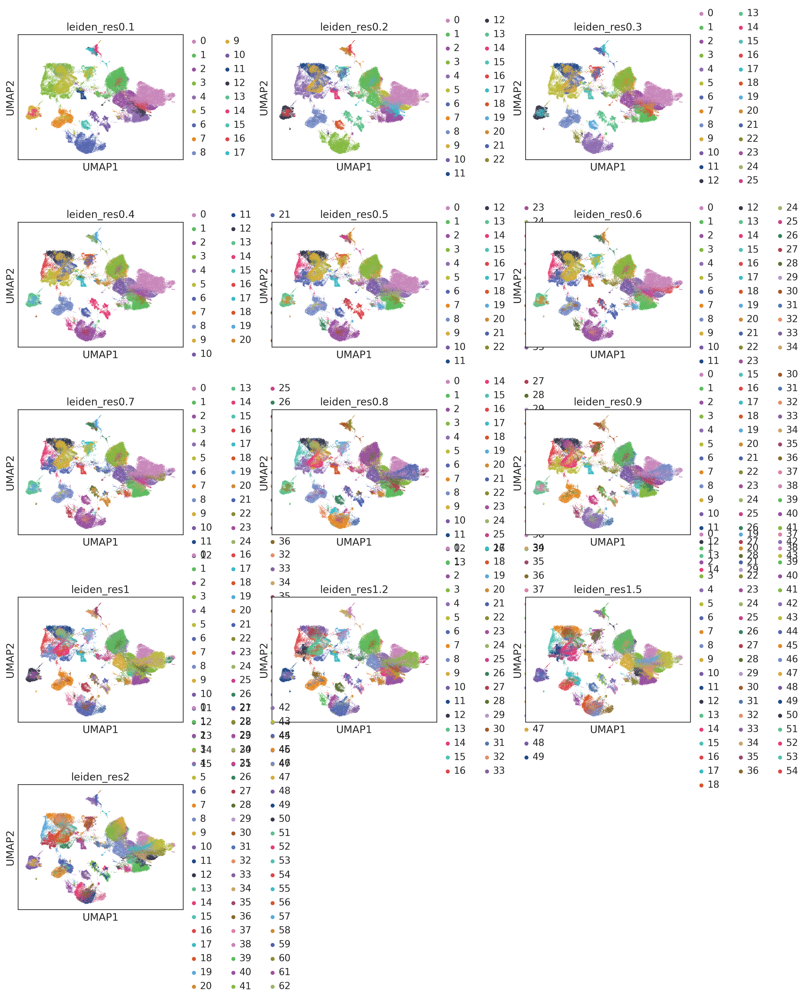

In [130]:
res_list = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7,0.8,0.9,1,1.2,1.5,2]
for res in res_list:
    sc.tl.leiden(adata, resolution=res, key_added=f"leiden_res{res}")


#sc.set_figure_params(frameon=False, dpi=100, dpi_save=300, fontsize=12)
fig = sc.pl.umap(
    adata=adata,
    color=[f"leiden_res{res}" for res in res_list],
    ncols=3, hspace=0.5, wspace=0.4, palette=Colors,
    return_fig=True, show=True,
)
fig.savefig(f'{save_folder}/01.major_celltype_harmony/01.GI_all_batch_batch_harmony_cluster_umap.pdf', dpi=300, format="pdf", bbox_inches="tight")

In [139]:
##提取每个cluster的TOP20的marker gene后续可以做富集
sc.tl.rank_genes_groups(adata, 'leiden_res0.6', n_genes=20, method='wilcoxon', key_added="rank_genes_groups")
markers_data = sc.get.rank_genes_groups_df(adata, group=None, key="rank_genes_groups")
markers_data.to_csv(f'{save_folder}/01.major_celltype_harmony/01.cluster_markers_top20.csv', index=False)

In [140]:
##提取每个cluster的TOP200的marker gene后续可以做富集
sc.tl.rank_genes_groups(adata, 'leiden_res0.6', n_genes=200, method='wilcoxon', key_added="rank_genes_groups")
markers_data = sc.get.rank_genes_groups_df(adata, group=None, key="rank_genes_groups")
markers_data.to_csv(f'{save_folder}/01.major_celltype_harmony/01.cluster_markers_top200.csv', index=False)

categories: 0, 1, 2, etc.
var_group_labels: Epithelial cell, Vascular Endothelial cell, Lymphatic Endothelial cell, etc.


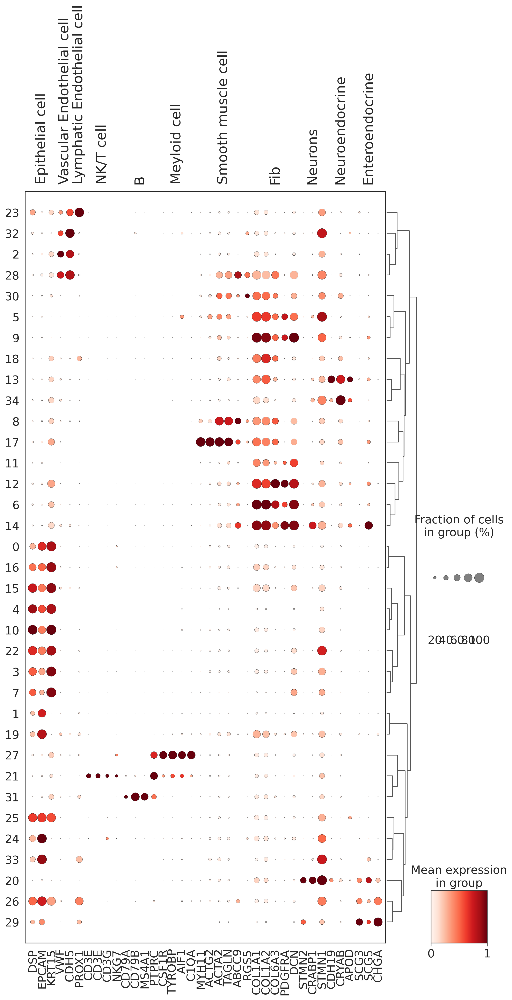

TypeError: close() argument must be a Figure, an int, a string, or None, not <class 'scanpy.plotting._dotplot.DotPlot'>

In [146]:
marker_genes_dict = {
    'Epithelial cell':['DSP','EPCAM','KRT15'],#上皮细胞
    #'Endothelial cell':['CLDN5','PECAM1','VWF'],#内皮细胞
    'Vascular Endothelial cell':['VWF','CDH5'],#血管内皮细胞
    'Lymphatic Endothelial cell':['PROX1'],#淋巴内皮细胞
    'NK/T cell':['CD3E','CD3E','CD3G','NKG7'],
    'B':['CD79A','CD79B','MS4A1','PTPRC'],
    'Meyloid cell':['CSF1R','TYROBP','AIF1','C1QA',],
    #'Erythrocyte':['HBA1','HBB','HBM',],
    'Smooth muscle cell':['MYH11','ACTG2','ACTA2','TAGLN','ABCC9','RGS5'],
    'Fib':['COL1A1','COL1A2','COL6A3','PDGFRA','DCN'],
    'Neurons':['STMN2','CRABP1','STMN1'],
    'Neuroendocrine':['CDH19','CRYAB','APOD',],
    'Enteroendocrine':['SCG3','SCG5','CHGA',],
    
}
sc.tl.dendrogram(adata,groupby='leiden_res0.6')

fig = sc.pl.dotplot(
    adata,
    marker_genes_dict,
    groupby='leiden_res0.6',
    dendrogram=True,
    color_map="Reds",
    swap_axes=False,
    use_raw=True,
    standard_scale="var",
    var_group_labels=False,
    figsize=(12,20),
    return_fig=True,  # 关键修改：返回图形对象
    show=False,      # 先不自动显示
)

# 3. 先保存PDF
fig.savefig(f'{save_folder}/01.major_celltype_harmony/01.cluster_markers_plot.pdf', bbox_inches='tight')

# 4. 再手动显示图形
plt.show()  # 这会弹出图形窗口

# 5. 可选：关闭图形释放内存
plt.close(fig)

In [147]:
##大类注释
cluster2annotation = {
    '0': 'Epithelial cell',
    '1': 'Epithelial cell',
    #'2': 'Epithelial cell',
    '3': 'Epithelial cell',
    '4': 'Epithelial cell',
    #'5': 'Epithelial cell',
    #'6': 'Fibroblast cell',
    '7': 'Epithelial cell',
    #'8': 'Fibroblast cell',
    #'9': 'Epithelial cell',
    #'10': 'Smooth muscle cell',
    #'11': 'Epithelial cell',
    #'12': 'Epithelial cell',
    #'13': 'Neuroendocrine',
    #'14': 'Endothelial cell',
    #'15': 'Epithelial cell',
    #'16': 'Fibroblast cell',
    #'17': 'Neuron cell',
    #'18': 'Immune cell', 
    #'19': 'Epithelial cell',
    #'20': 'Epithelial cell',
    #'21': 'Fibroblast cell',
    #'22': 'Epithelial cell',
    #'23': 'Fibroblast cell',
    #'24': 'Mast cell',#KIT
}

adata.obs['major_celltype'] = adata.obs['leiden_res0.6'].map(cluster2annotation).astype('category')
adata

AnnData object with n_obs × n_vars = 73097 × 15098
    obs: 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'sample_new', 'species', 'S_score', 'G2M_score', 'phase', 'cc_diff', 'leiden', 'leiden_res0.1', 'leiden_res0.2', 'leiden_res0.3', 'leiden_res0.4', 'leiden_res0.5', 'leiden_res0.6', 'leiden_res0.7', 'leiden_res0.8', 'leiden_res0.9', 'leiden_res1', 'leiden_res1.2', 'leiden_res1.5', 'leiden_res2', 'major_celltype'
    var: 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable_nbatches', 'highly_variable_intersection', 'highly_variable'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'sample_new_colors', 'phase_colors', 'species_colors', 'harmony_nn', 'rank_genes_groups', 'leiden_res0.1', 'leiden_res0.2', 'leiden_res0.3', 'leiden_res0.4', 'leiden_res0.5', 'leiden_res0.6', 'leiden_res0.7', 'leiden_res0.8', 'leiden_res0.9', 'leiden_res1', 'leiden_res1.2', 'leiden_res1.5', 'leiden_res2', 'leiden_res0.1_colors', 'leiden_res0.2_colors', 

[<AxesSubplot: title={'center': 'VWF'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot: title={'center': 'CDH5'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot: title={'center': 'DSP'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot: title={'center': 'EPCAM'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot: title={'center': 'KRT15'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot: title={'center': 'KRT5'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot: title={'center': 'KRT8'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot: title={'center': 'COL3A1'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot: title={'center': 'DCN'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot: title={'center': 'LUM'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot: title={'center': 'PTPRC'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot: title={'center': 'TYROBP'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot: title={'center': 'CTSS'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot: title={'center': 'CD

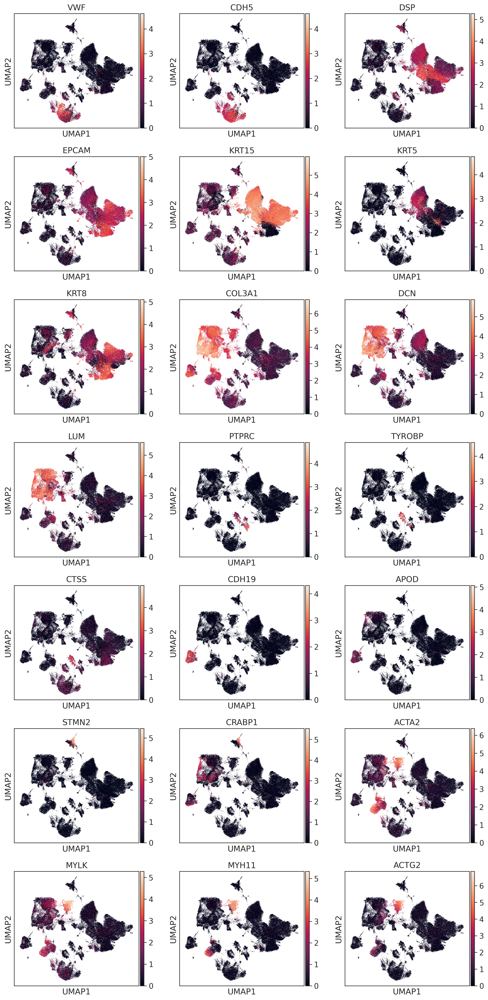

In [136]:
sc.pl.umap(
    adata,
    color=['VWF','CDH5','DSP','EPCAM','KRT15','KRT5','KRT8','COL3A1','DCN','LUM','PTPRC','TYROBP','CTSS','CDH19','APOD','STMN2','CRABP1','ACTA2','MYLK','MYH11','ACTG2'],
    ncols=3,  # 每行显示3个基因
    show=False, # 先不自动显示
    #layer='X_log1p'
)

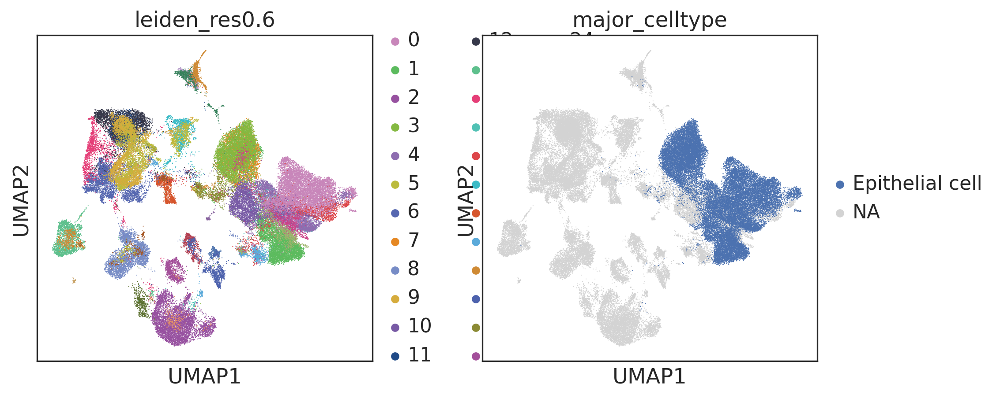

In [148]:
sc.pl.umap(adata,color=['leiden_res0.6','major_celltype'])
#sc.pl.umap(adata,color=['leiden_res0.6'])